In [93]:
import os
import pandas as pd
import shutil

# Buat direktori baru untuk dataset
os.makedirs('lung_dataset/image', exist_ok=True)

# Baca kedua file CSV
train_df = pd.read_csv('CheXpert-v1.0-small/train.csv')
valid_df = pd.read_csv('CheXpert-v1.0-small/valid.csv')

# Gabungkan kedua dataframe
combined_df = pd.concat([train_df, valid_df], ignore_index=True)

# Ubah path gambar dan salin file gambar ke direktori baru
def copy_and_update_path(row):
    # Ambil index baris untuk penamaan unik
    idx = row.name + 1  # Mulai dari 1
    # Format nama file baru
    new_filename = f'patient{idx:05d}.jpg'
    new_path = f'lung_dataset/image/{new_filename}'
    old_path = row['Path']

    print(f"Memproses file ke-{row.name + 1}: {old_path} -> {new_path}")
    # Salin file gambar jika belum ada
    if not os.path.exists(new_path):
        shutil.copy2(old_path, new_path)
    return new_path

combined_df['Path'] = combined_df.apply(copy_and_update_path, axis=1)

# Simpan dataframe gabungan ke CSV baru
combined_df.to_csv('lung_dataset/dataset.csv', index=False)

Memproses file ke-1: CheXpert-v1.0-small/train/patient00001/study1/view1_frontal.jpg -> lung_dataset/image/patient00001.jpg
Memproses file ke-2: CheXpert-v1.0-small/train/patient00002/study2/view1_frontal.jpg -> lung_dataset/image/patient00002.jpg
Memproses file ke-3: CheXpert-v1.0-small/train/patient00002/study1/view1_frontal.jpg -> lung_dataset/image/patient00003.jpg
Memproses file ke-4: CheXpert-v1.0-small/train/patient00002/study1/view2_lateral.jpg -> lung_dataset/image/patient00004.jpg
Memproses file ke-5: CheXpert-v1.0-small/train/patient00003/study1/view1_frontal.jpg -> lung_dataset/image/patient00005.jpg
Memproses file ke-6: CheXpert-v1.0-small/train/patient00004/study1/view1_frontal.jpg -> lung_dataset/image/patient00006.jpg
Memproses file ke-7: CheXpert-v1.0-small/train/patient00004/study1/view2_lateral.jpg -> lung_dataset/image/patient00007.jpg
Memproses file ke-8: CheXpert-v1.0-small/train/patient00005/study1/view1_frontal.jpg -> lung_dataset/image/patient00008.jpg
Memprose

Baris 1:
  Path baru: lung_dataset/image/patient00001.jpg, Ada: True
  Path lama: CheXpert-v1.0-small/train/patient00001/study1/view1_frontal.jpg, Ada: True


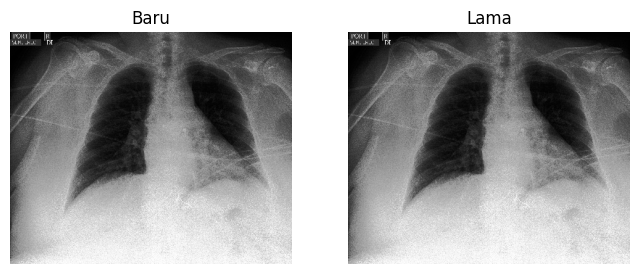

Baris 2:
  Path baru: lung_dataset/image/patient00002.jpg, Ada: True
  Path lama: CheXpert-v1.0-small/train/patient00002/study2/view1_frontal.jpg, Ada: True


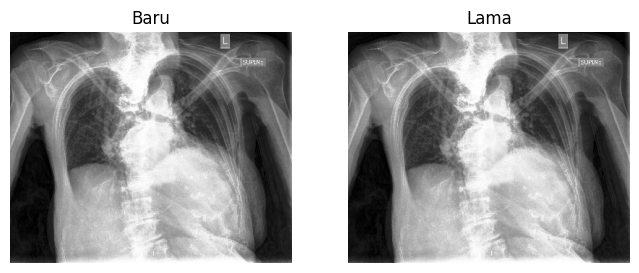

Baris 3:
  Path baru: lung_dataset/image/patient00003.jpg, Ada: True
  Path lama: CheXpert-v1.0-small/train/patient00002/study1/view1_frontal.jpg, Ada: True


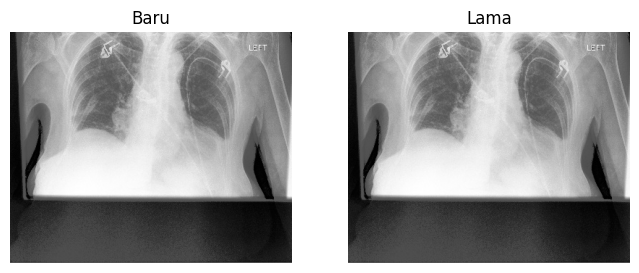

Baris 4:
  Path baru: lung_dataset/image/patient00004.jpg, Ada: True
  Path lama: CheXpert-v1.0-small/train/patient00002/study1/view2_lateral.jpg, Ada: True


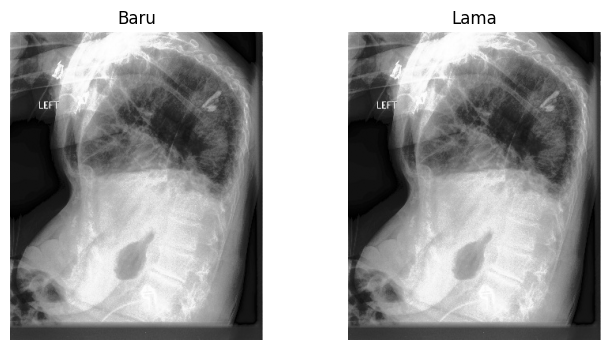

Baris 5:
  Path baru: lung_dataset/image/patient00005.jpg, Ada: True
  Path lama: CheXpert-v1.0-small/train/patient00003/study1/view1_frontal.jpg, Ada: True


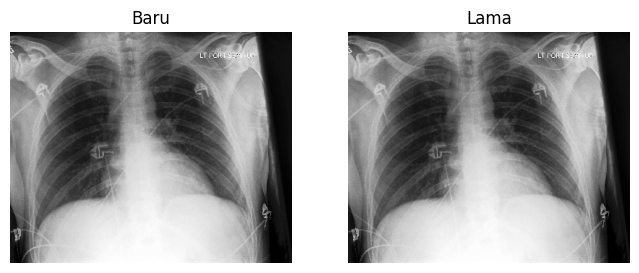

In [94]:
from PIL import Image

# Cek apakah file gambar pada combined_df benar-benar ada dan sesuai dengan path aslinya di train_df/valid_df

# Buat mapping dari path baru ke path lama
# Gabungkan train_df dan valid_df
original_df = pd.concat([train_df, valid_df], ignore_index=True)
original_paths = original_df['Path'].tolist()

# Ambil path baru dan path lama dari combined_df dan original_df
paired = []
for idx, row in combined_df.iterrows():
    new_path = row['Path']
    # Path lama di original_df sesuai urutan
    old_path = original_paths[idx]
    # Cek apakah file gambar baru ada
    new_exists = os.path.exists(new_path)
    # Cek apakah file gambar lama ada
    old_exists = os.path.exists(old_path)
    paired.append((new_path, new_exists, old_path, old_exists))

# Tampilkan 5 contoh hasil pengecekan
for i in range(5):
    print(f"Baris {i+1}:")
    print(f"  Path baru: {paired[i][0]}, Ada: {paired[i][1]}")
    print(f"  Path lama: {paired[i][2]}, Ada: {paired[i][3]}")
    # Tampilkan gambar jika file ada
    import matplotlib.pyplot as plt

    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    for j, (img_path, exists, title) in enumerate([
        (paired[i][0], paired[i][1], "Baru"),
        (paired[i][2], paired[i][3], "Lama")
    ]):
        axs[j].set_title(title)
        axs[j].axis('off')
        if exists:
            img = Image.open(img_path)
            axs[j].imshow(img, cmap='gray')
        else:
            axs[j].text(0.5, 0.5, 'File tidak ada', ha='center', va='center')
    plt.show()